Para reforzar lo que hemos aprenddido hasta aquí, vamos a trabajar un ejemplo sencillo de mapas utilizando los datos de COVID-19 en México. 

Vamos a partir de una base de datos ya preprocesada, en este caso contiene sólo los agregados de casos _nuevos_ por semana para todos los municipios del país. Para simplificar el ejercicio y centrarnos en la producción de mapas, vamos a utilizar una versión ya procesada de los datos que se encuentra en la carpeta de datos del libro:

* [Datos Covid](https://www.dropbox.com/s/x9p5b2k9avaj9lw/agregados_semana_municipio.pkl?dl=1): Agregados por municipio y mes (2022)
* [Geometría de municipios](https://www.dropbox.com/s/6khaan1evliv26d/municipios_pob_2020_simple.json?dl=1): versión simplificada de las geometrías de los municipios y población al 2020

Importamos las librerías


In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import mapclassify
import folium

## Un mapa sencillo

Empecemos por leer las geometrías de municipios:

In [2]:
municipios = gpd.read_file('datos/municipios_pob_2020_simple.json')
municipios

,id,oid,municipio_cvegeo,municipio,pob2020,pob_0a4,pob_0a9,pob60ym,entidad_cvegeo,geometry
0,827,525,16046,Juárez,15290,1557,3122,1911,16,"POLYGON ((-100.45693 19.33414, -100.45818 19.3..."
1,828,209,16047,Jungapeo,22358,2470,4920,2608,16,"POLYGON ((-100.44063 19.51413, -100.44814 19.5..."
2,829,564,16048,Lagunillas,5862,550,1111,844,16,"POLYGON ((-101.38329 19.59813, -101.38279 19.6..."
3,830,524,16049,Madero,18769,2049,4136,2055,16,"POLYGON ((-101.11644 19.53327, -101.11713 19.5..."
4,67,44,05035,Torreón,744247,65682,129805,85778,05,"MULTIPOLYGON (((-102.98871 24.79622, -102.9930..."
...,...,...,...,...,...,...,...,...,...,...
2452,2452,2388,32053,Villa González Ortega,13945,1481,2926,1599,32,"POLYGON ((-101.94821 22.65201, -101.95269 22.6..."
2453,2453,2417,32054,Villa Hidalgo,20177,2078,4191,2036,32,"POLYGON ((-101.65599 22.51381, -101.65651 22.5..."
2454,2454,1407,32055,Villanueva,31804,2738,5540,5324,32,"POLYGON ((-102.69428 22.62230, -102.69370 22.6..."
2455,2455,2411,32056,Zacatecas,155533,12609,25488,15549,32,"POLYGON ((-102.58542 22.81149, -102.58522 22.8..."


Lo primero que vamos a hacer es un mapa rápido de población a nivel municipal. Para eso vamos a usar el métdo [plot](https://geopandas.org/en/stable/docs/user_guide/mapping.html) de geopandas que nos da chance de hacer mapas bien fácil

<AxesSubplot: >

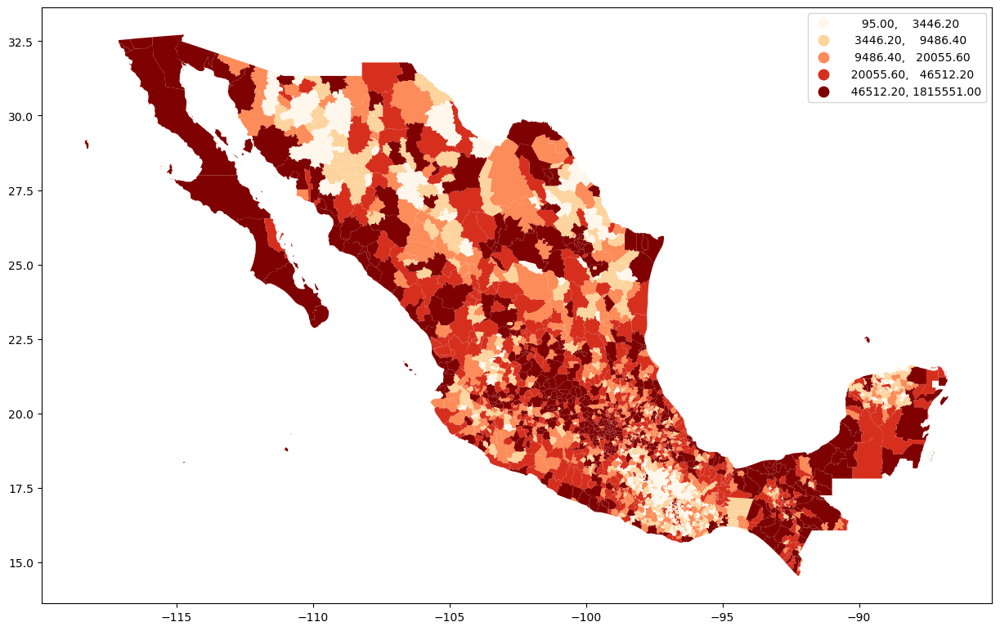

In [3]:
municipios.plot(column='pob2020', cmap='OrRd',figsize=(15, 10), scheme="quantiles", legend=True)

Noten cómo usamos el argumento `scheme="quantiles"` para hacer un mapa de cualtiles. Podemos usar cualquier clasificación de [mapclassify](https://pysal.org/mapclassify/).

Igual que antes, podemos hacer modificaciones al estilo para ajustarlo a nuestras necesidades.

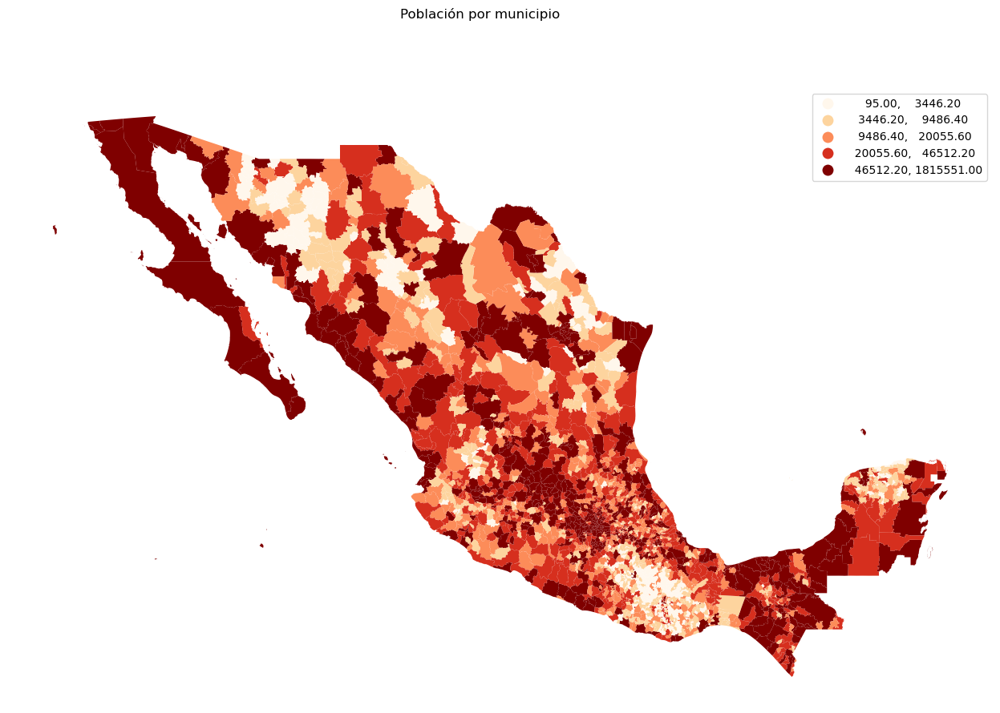

In [4]:
fig, ax = plt.subplots(1, figsize=(20,10))
municipios.plot(column='pob2020', cmap='OrRd',figsize=(15, 10), scheme="quantiles", legend=True, ax=ax)
ax.set_axis_off() 
fig.suptitle("Población por municipio") # A través de la función '.suptitle()' aplicada a la figura se coloca el título.
plt.show()

## Mapas de COVID

El primer paso para mapear los casos de covid es leerlos y unirlos a las geometrías de los municipios, empecemos por leer la misma base que hemos usado ya antes:

In [7]:
df = pd.read_pickle("datos/agregados_semana_municipio.pkl")
df.head()

Nuevos Casos  \
FECHA_SINTOMAS CLAVE_MUNICIPIO_RES MUNICIPIO_RES                       
2020-01-05     01001               AGUASCALIENTES                 11   
               01006               PABELLÓN DE ARTEAGA             1   
               01009               TEPEZALÁ                        1   
               02001               ENSENADA                        1   
               02002               MEXICALI                       11   

                                                        Defunciones  
FECHA_SINTOMAS CLAVE_MUNICIPIO_RES MUNICIPIO_RES                     
2020-01-05     01001               AGUASCALIENTES                 0  
               01006               PABELLÓN DE ARTEAGA            0  
               01009               TEPEZALÁ                       0  
               02001               ENSENADA                       0  
               02002               MEXICALI                       0

::: {.callout-important}
Bajamos los datos en el formato [`pickle`](https://docs.python.org/3/library/pickle.html) de Python. Es una forma estandarizada de _serializar_ objetos de Python que es útil cuando queremos guardar un objeto arbitrario para después reutilizarlo en Python.

:::


Estos datos corresponden a toda la serie de tiempo, entonces para cada municipio hay toda una serie de valores. Para empezar a hacer mapas vamos a seleccionar una fecha en específico, lo más fácil es seleccionar la última disponible (vamos a seleccionar por `FECHA_INGRESO`, pero podríamos usar cualquier otra)

In [8]:
ultima_fecha = df.reset_index().loc[df.reset_index()['FECHA_SINTOMAS'] == df.reset_index()['FECHA_SINTOMAS'].max()]
ultima_fecha.head()

,FECHA_SINTOMAS,CLAVE_MUNICIPIO_RES,MUNICIPIO_RES,Nuevos Casos,Defunciones
159076,2022-01-23,01001,AGUASCALIENTES,10,0
159077,2022-01-23,01007,RINCÓN DE ROMOS,1,0
159078,2022-01-23,02001,ENSENADA,9,0
159079,2022-01-23,02002,MEXICALI,12,0
159080,2022-01-23,02004,TIJUANA,12,0


Tenemos la lista de los municipios *que tuvieron* casos en la fecha que estamos analizando, para hacer un mapa necesitamos unir estos datos a la geometría de los municipios.

Primero vamos a seleccionar, a partir del GeoDataFrame que ya tenemos sólo los municipios de la entidad que estamos analizando. A partir de eso podemos realizar una unión via la clave del municipio, sólo tenemos que tener cuidado de utilizar el tipo de unión adecuada para no dejar fuera los municipios sin casos.

In [9]:
casos_municipio = (municipios
                   .merge(ultima_fecha, left_on='municipio_cvegeo', right_on='CLAVE_MUNICIPIO_RES', how='left') # Unimos con los municipios
                   .drop(columns=['CLAVE_MUNICIPIO_RES', 'MUNICIPIO_RES']) # eliminamos dos columnas que ya no vamosd a usar
                   .fillna(0) # Los municipios sin casos deben tener 0 en lugar de NaN
                   )
casos_municipio

,id,oid,municipio_cvegeo,municipio,pob2020,pob_0a4,pob_0a9,pob60ym,entidad_cvegeo,geometry,FECHA_SINTOMAS,Nuevos Casos,Defunciones
0,827,525,16046,Juárez,15290,1557,3122,1911,16,"POLYGON ((-100.45693 19.33414, -100.45818 19.3...",0,0.0,0.0
1,828,209,16047,Jungapeo,22358,2470,4920,2608,16,"POLYGON ((-100.44063 19.51413, -100.44814 19.5...",0,0.0,0.0
2,829,564,16048,Lagunillas,5862,550,1111,844,16,"POLYGON ((-101.38329 19.59813, -101.38279 19.6...",0,0.0,0.0
3,830,524,16049,Madero,18769,2049,4136,2055,16,"POLYGON ((-101.11644 19.53327, -101.11713 19.5...",0,0.0,0.0
4,67,44,05035,Torreón,744247,65682,129805,85778,05,"MULTIPOLYGON (((-102.98871 24.79622, -102.9930...",2022-01-23 00:00:00,13.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2452,2452,2388,32053,Villa González Ortega,13945,1481,2926,1599,32,"POLYGON ((-101.94821 22.65201, -101.95269 22.6...",0,0.0,0.0
2453,2453,2417,32054,Villa Hidalgo,20177,2078,4191,2036,32,"POLYGON ((-101.65599 22.51381, -101.65651 22.5...",0,0.0,0.0
2454,2454,1407,32055,Villanueva,31804,2738,5540,5324,32,"POLYGON ((-102.69428 22.62230, -102.69370 22.6...",0,0.0,0.0
2455,2455,2411,32056,Zacatecas,155533,12609,25488,15549,32,"POLYGON ((-102.58542 22.81149, -102.58522 22.8...",2022-01-23 00:00:00,67.0,0.0


Y hacemos un primer mapa

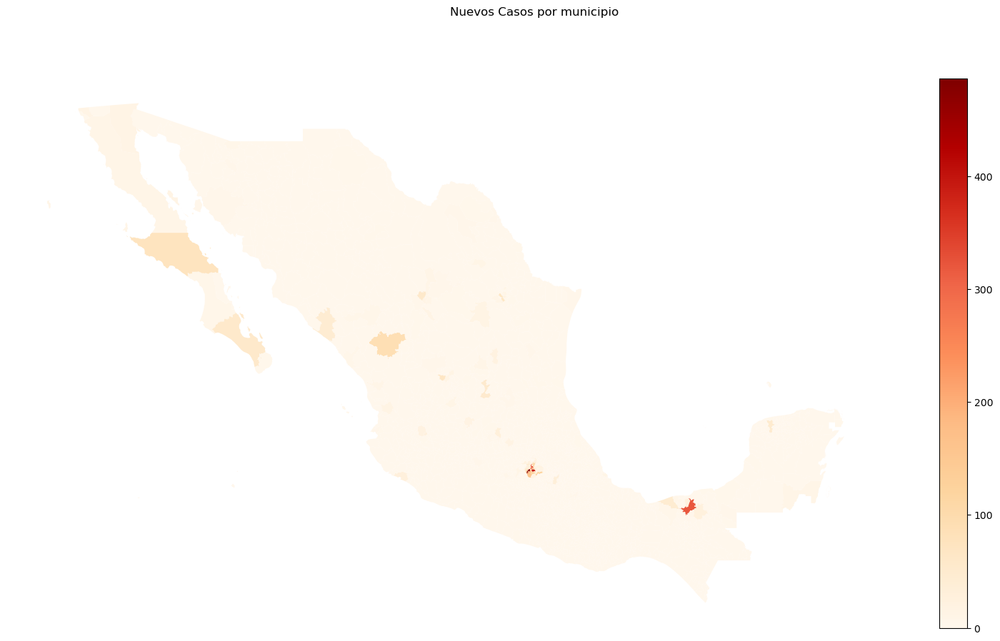

In [10]:
fig, ax = plt.subplots(1, figsize=(20,10))
casos_municipio.plot(column='Nuevos Casos', cmap='OrRd',figsize=(15, 10), legend=True, ax=ax)
ax.set_axis_off() 
fig.suptitle("Nuevos Casos por municipio") # A través de la función '.suptitle()' aplicada a la figura se coloca el título.
plt.show()

## Mapa interactivo

Con los mismos datos podemos usar [folium](https://python-visualization.github.io/folium/#:~:text=folium%20makes%20it%20easy%20to,as%20markers%20on%20the%20map.) para hacer un mapa interactivo muy fácilmente

In [11]:
m = folium.Map(location=[19.4326018, -99.1332049], zoom_start=5) # Creamos la instancia de folium
folium.Choropleth( # Instanciamos un mapa de coropletas
    geo_data=casos_municipio[["municipio_cvegeo", "Nuevos Casos", "geometry"]], # Pasamos la geometría de los municipios
    data=casos_municipio[["municipio_cvegeo", "Nuevos Casos"]], # Las variables que vamos a usar en el mapa
    columns=["municipio_cvegeo", "Nuevos Casos"], # La primera columna une geometrías y datos, la segunda es la variable que vamos a mapear
    key_on="feature.properties.municipio_cvegeo", # Cómo se unen los datos
    bins=4, # Cuántos intervalos iguales queremos en la clasificación 
    fill_color="OrRd", # La escala de colores
    fill_opacity=0.7, # Opacidad del relleno
    line_opacity=0.2, # opacidad de la línea
    legend_name="Nuevos Casos",
).add_to(m)
m